In [1]:
import pandas as pd
import numpy as np
import datetime
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
# Dataset from https://www.kaggle.com/jessemostipak/hotel-booking-demand

df = pd.read_csv('./Data/hotel_bookings.csv')

In [3]:
df

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,...,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date
0,Resort Hotel,0,342,2015,July,27,1,0,0,2,...,No Deposit,NaN,NaN,0,Transient,0.00,0,0,Check-Out,2015-07-01
1,Resort Hotel,0,737,2015,July,27,1,0,0,2,...,No Deposit,NaN,NaN,0,Transient,0.00,0,0,Check-Out,2015-07-01
2,Resort Hotel,0,7,2015,July,27,1,0,1,1,...,No Deposit,NaN,NaN,0,Transient,75.00,0,0,Check-Out,2015-07-02
3,Resort Hotel,0,13,2015,July,27,1,0,1,1,...,No Deposit,304.0,NaN,0,Transient,75.00,0,0,Check-Out,2015-07-02
4,Resort Hotel,0,14,2015,July,27,1,0,2,2,...,No Deposit,240.0,NaN,0,Transient,98.00,0,1,Check-Out,2015-07-03
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119385,City Hotel,0,23,2017,August,35,30,2,5,2,...,No Deposit,394.0,NaN,0,Transient,96.14,0,0,Check-Out,2017-09-06
119386,City Hotel,0,102,2017,August,35,31,2,5,3,...,No Deposit,9.0,NaN,0,Transient,225.43,0,2,Check-Out,2017-09-07
119387,City Hotel,0,34,2017,August,35,31,2,5,2,...,No Deposit,9.0,NaN,0,Transient,157.71,0,4,Check-Out,2017-09-07
119388,City Hotel,0,109,2017,August,35,31,2,5,2,...,No Deposit,89.0,NaN,0,Transient,104.40,0,0,Check-Out,2017-09-07


In [4]:
df.columns

Index(['hotel', 'is_canceled', 'lead_time', 'arrival_date_year',
       'arrival_date_month', 'arrival_date_week_number',
       'arrival_date_day_of_month', 'stays_in_weekend_nights',
       'stays_in_week_nights', 'adults', 'children', 'babies', 'meal',
       'country', 'market_segment', 'distribution_channel',
       'is_repeated_guest', 'previous_cancellations',
       'previous_bookings_not_canceled', 'reserved_room_type',
       'assigned_room_type', 'booking_changes', 'deposit_type', 'agent',
       'company', 'days_in_waiting_list', 'customer_type', 'adr',
       'required_car_parking_spaces', 'total_of_special_requests',
       'reservation_status', 'reservation_status_date'],
      dtype='object')

In [5]:
df.describe()

,is_canceled,lead_time,arrival_date_year,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,booking_changes,agent,company,days_in_waiting_list,adr,required_car_parking_spaces,total_of_special_requests
count,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119386.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,103050.000000,6797.000000,119390.000000,119390.000000,119390.000000,119390.000000
mean,0.370416,104.011416,2016.156554,27.165173,15.798241,0.927599,2.500302,1.856403,0.103890,0.007949,0.031912,0.087118,0.137097,0.221124,86.693382,189.266735,2.321149,101.831122,0.062518,0.571363
std,0.482918,106.863097,0.707476,13.605138,8.780829,0.998613,1.908286,0.579261,0.398561,0.097436,0.175767,0.844336,1.497437,0.652306,110.774548,131.655015,17.594721,50.535790,0.245291,0.792798
min,0.000000,0.000000,2015.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,6.000000,0.000000,-6.380000,0.000000,0.000000
25%,0.000000,18.000000,2016.000000,16.000000,8.000000,0.000000,1.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9.000000,62.000000,0.000000,69.290000,0.000000,0.000000
50%,0.000000,69.000000,2016.000000,28.000000,16.000000,1.000000,2.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,14.000000,179.000000,0.000000,94.575000,0.000000,0.000000
75%,1.000000,160.000000,2017.000000,38.000000,23.000000,2.000000,3.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,229.000000,270.000000,0.000000,126.000000,0.000000,1.000000
max,1.000000,737.000000,2017.000000,53.000000,31.000000,19.000000,50.000000,55.000000,10.000000,10.000000,1.000000,26.000000,72.000000,21.000000,535.000000,543.000000,391.000000,5400.000000,8.000000,5.000000


In [6]:
df = df.drop(['arrival_date_week_number', 'agent', 'company','reservation_status_date'], axis = 1)

In [7]:
df.children = df.children.fillna(0)
df.country = df.country.fillna(0)

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119390 entries, 0 to 119389
Data columns (total 28 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   hotel                           119390 non-null  object 
 1   is_canceled                     119390 non-null  int64  
 2   lead_time                       119390 non-null  int64  
 3   arrival_date_year               119390 non-null  int64  
 4   arrival_date_month              119390 non-null  object 
 5   arrival_date_day_of_month       119390 non-null  int64  
 6   stays_in_weekend_nights         119390 non-null  int64  
 7   stays_in_week_nights            119390 non-null  int64  
 8   adults                          119390 non-null  int64  
 9   children                        119390 non-null  float64
 10  babies                          119390 non-null  int64  
 11  meal                            119390 non-null  object 
 12  country         

In [ ]:
# DF IN ORIGINAL STATE

In [9]:
df = pd.get_dummies(df)

In [12]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119390 entries, 0 to 119389
Columns: 259 entries, is_canceled to reservation_status_No-Show
dtypes: float64(2), int64(15), uint8(242)
memory usage: 43.0 MB


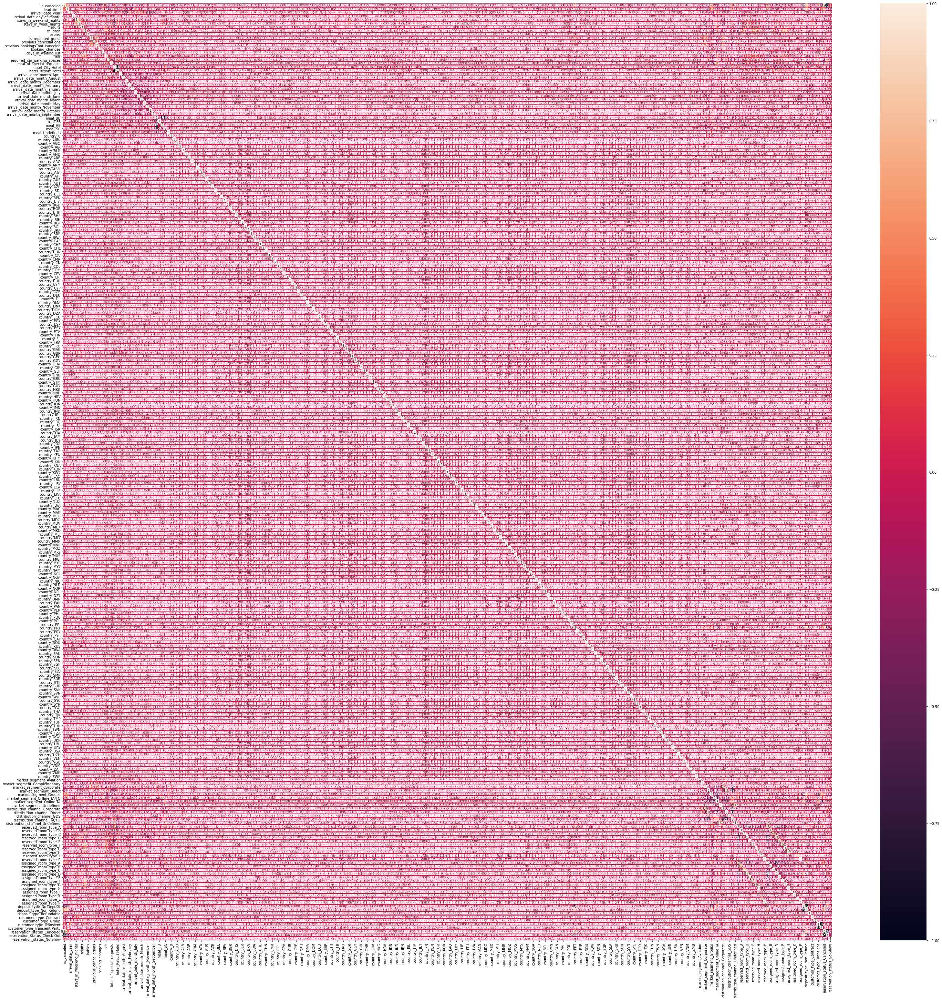

In [13]:
fig, ax = plt.subplots(figsize=(50, 50)) 
sns.heatmap(df.corr(), annot=True, ax = ax)

# Cancellation Rate

Creating df2 without countries

In [14]:
filter_col = [col for col in df if col.startswith('country')]
df2 = df.drop(filter_col, axis = 1)
df2

,is_canceled,lead_time,arrival_date_year,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,booking_changes,days_in_waiting_list,adr,required_car_parking_spaces,total_of_special_requests,hotel_City Hotel,hotel_Resort Hotel,arrival_date_month_April,arrival_date_month_August,arrival_date_month_December,arrival_date_month_February,arrival_date_month_January,arrival_date_month_July,arrival_date_month_June,arrival_date_month_March,arrival_date_month_May,arrival_date_month_November,arrival_date_month_October,arrival_date_month_September,meal_BB,meal_FB,meal_HB,meal_SC,meal_Undefined,market_segment_Aviation,market_segment_Complementary,market_segment_Corporate,market_segment_Direct,...,market_segment_Offline TA/TO,market_segment_Online TA,market_segment_Undefined,distribution_channel_Corporate,distribution_channel_Direct,distribution_channel_GDS,distribution_channel_TA/TO,distribution_channel_Undefined,reserved_room_type_A,reserved_room_type_B,reserved_room_type_C,reserved_room_type_D,reserved_room_type_E,reserved_room_type_F,reserved_room_type_G,reserved_room_type_H,reserved_room_type_L,reserved_room_type_P,assigned_room_type_A,assigned_room_type_B,assigned_room_type_C,assigned_room_type_D,assigned_room_type_E,assigned_room_type_F,assigned_room_type_G,assigned_room_type_H,assigned_room_type_I,assigned_room_type_K,assigned_room_type_L,assigned_room_type_P,deposit_type_No Deposit,deposit_type_Non Refund,deposit_type_Refundable,customer_type_Contract,customer_type_Group,customer_type_Transient,customer_type_Transient-Party,reservation_status_Canceled,reservation_status_Check-Out,reservation_status_No-Show
0,0,342,2015,1,0,0,2,0.0,0,0,0,0,3,0,0.00,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,...,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,1,0
1,0,737,2015,1,0,0,2,0.0,0,0,0,0,4,0,0.00,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,...,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,1,0
2,0,7,2015,1,0,1,1,0.0,0,0,0,0,0,0,75.00,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,...,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,1,0
3,0,13,2015,1,0,1,1,0.0,0,0,0,0,0,0,75.00,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,...,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,1,0
4,0,14,2015,1,0,2,2,0.0,0,0,0,0,0,0,98.00,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119385,0,23,2017,30,2,5,2,0.0,0,0,0,0,0,0,96.14,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,...,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,1,0
119386,0,102,2017,31,2,5,3,0.0,0,0,0,0,0,0,225.43,0,2,1,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,1,0
119387,0,34,2017,31,2,5,2,0.0,0,0,0,0,0,0,157.71,0,4,1,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,1,0
119388,0,109,2017,31,2,5,2,0.0,0,0,0,0,0,0,104.40,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,...,0,1,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,1,0


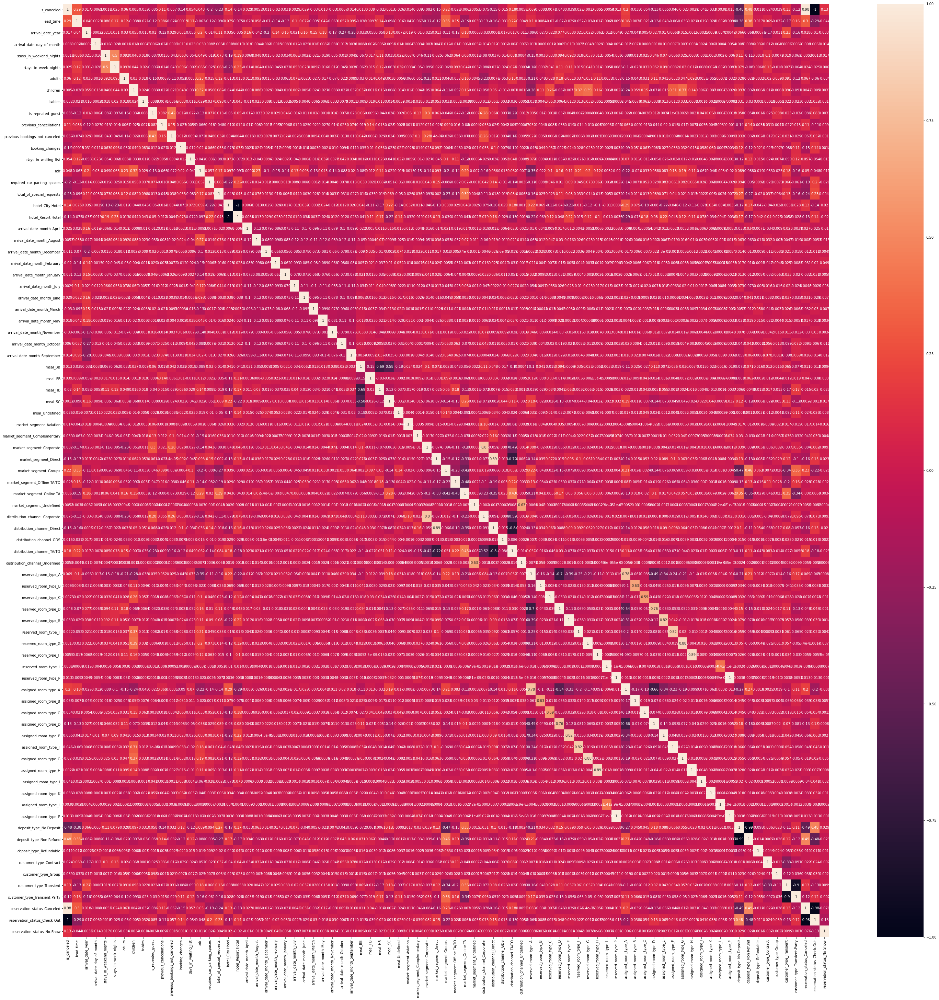

In [15]:
fig, ax = plt.subplots(figsize=(50, 50)) 
sns.heatmap(df2.corr(), annot=True, ax = ax)

Creating df3 for the customer proveniences (country information) impact on cancellation rates

In [16]:
df3 = df.filter(like='country')
df3 = pd.concat([df3, df.is_canceled], axis = 1)
df3.head(3)

,country_0,country_ABW,country_AGO,country_AIA,country_ALB,country_AND,country_ARE,country_ARG,country_ARM,country_ASM,country_ATA,country_ATF,country_AUS,country_AUT,country_AZE,country_BDI,country_BEL,country_BEN,country_BFA,country_BGD,country_BGR,country_BHR,country_BHS,country_BIH,country_BLR,country_BOL,country_BRA,country_BRB,country_BWA,country_CAF,country_CHE,country_CHL,country_CHN,country_CIV,country_CMR,country_CN,country_COL,country_COM,country_CPV,country_CRI,...,country_QAT,country_ROU,country_RUS,country_RWA,country_SAU,country_SDN,country_SEN,country_SGP,country_SLE,country_SLV,country_SMR,country_SRB,country_STP,country_SUR,country_SVK,country_SVN,country_SWE,country_SYC,country_SYR,country_TGO,country_THA,country_TJK,country_TMP,country_TUN,country_TUR,country_TWN,country_TZA,country_UGA,country_UKR,country_UMI,country_URY,country_USA,country_UZB,country_VEN,country_VGB,country_VNM,country_ZAF,country_ZMB,country_ZWE,is_canceled
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


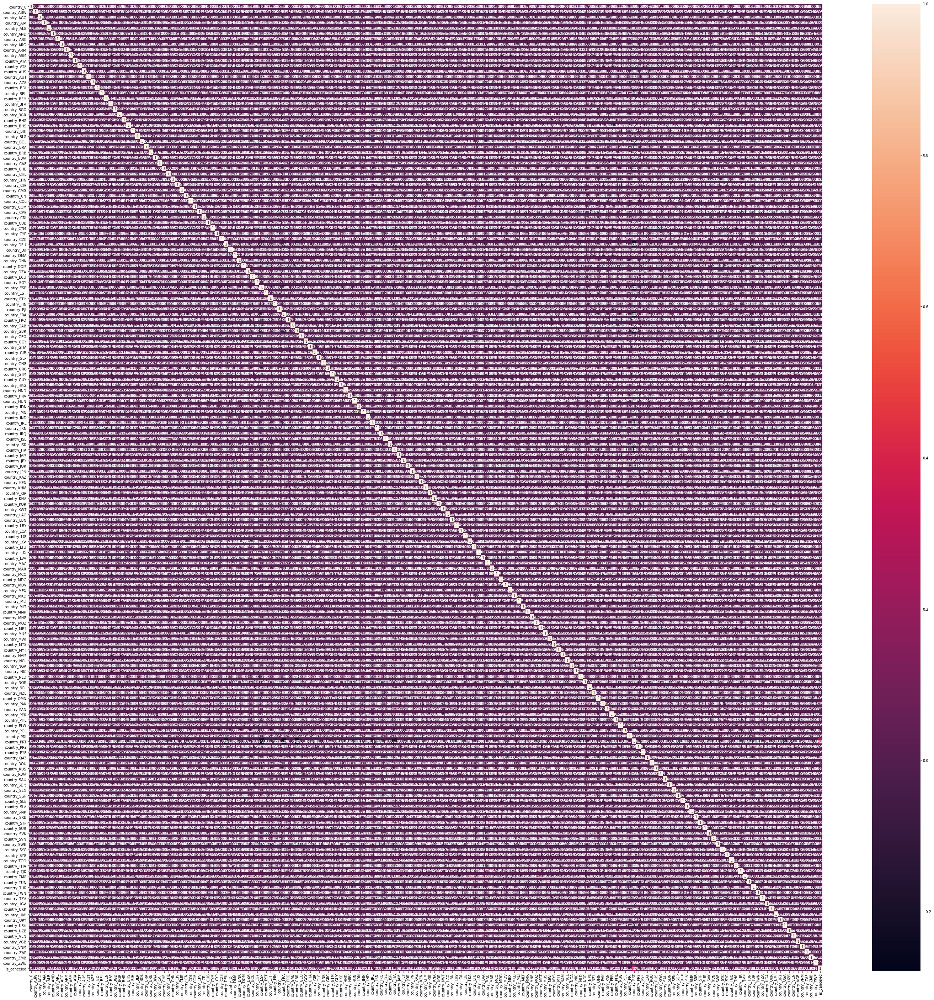

In [17]:
fig, ax = plt.subplots(figsize=(50, 50)) 
sns.heatmap(df3.corr(), annot=True, ax = ax)

Obviously only "country_PRT" plays a role in cancellation rate

# Creating df4 with only relevant columns for prediction of cancellation

In [10]:
selected_cols = ('market_segment', 'distribution_channel', 'deposit_type', 'hotel')
filter_cols = [col for col in df if col.startswith(selected_cols)]
df4 = df[['is_canceled', 'lead_time', 'previous_cancellations', 'required_car_parking_spaces', 'total_of_special_requests', 'country_PRT']]
df5 = df[filter_cols]
df4 = pd.concat([df4, df5], axis = 1)

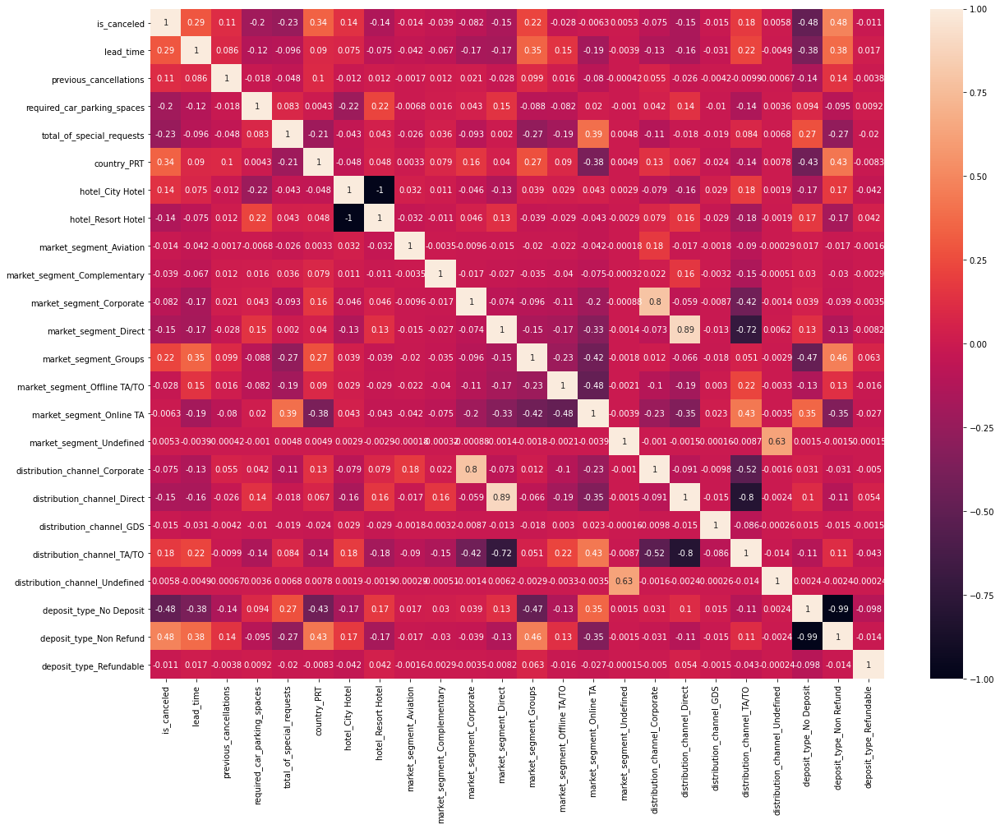

In [19]:
fig, ax = plt.subplots(figsize=(20, 15)) 
sns.heatmap(df4.corr(), annot=True, ax = ax)

# Cancellation prediction - all data (df) but without reservation_status

In [11]:
X = df.drop(['is_canceled', 'reservation_status_Canceled', 'reservation_status_Check-Out', 'reservation_status_No-Show'], axis = 1)
y = df['is_canceled']
y = np.array(y)

In [12]:
# Scaling

X_scaled = StandardScaler().fit_transform(X)

In [13]:
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size = 0.2, random_state = 3)

# Logistic Regression

In [24]:
model_lr = LogisticRegression().fit(X_train, y_train)
model_lr_prediction = model_lr.predict(X_test)
version_lr = accuracy_score(y_test, model_lr_prediction)
version_lr

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


0.8181170952341067

In [25]:
kappa_lr = cohen_kappa_score(y_test, model_lr_prediction)
kappa_lr

0.5952011495829967

Feature importance

Feature: 0, Score: 0.59461
Feature: 1, Score: 0.20352
Feature: 2, Score: 0.00106
Feature: 3, Score: 0.08238
Feature: 4, Score: 0.14156
Feature: 5, Score: 0.11790
Feature: 6, Score: 0.09501
Feature: 7, Score: 0.01155
Feature: 8, Score: -0.16327
Feature: 9, Score: 1.74586
Feature: 10, Score: -0.53286
Feature: 11, Score: -0.23724
Feature: 12, Score: -0.04410
Feature: 13, Score: 0.24901
Feature: 14, Score: -5.13124
Feature: 15, Score: -0.61676
Feature: 16, Score: 0.02592
Feature: 17, Score: -0.02592
Feature: 18, Score: 0.03149
Feature: 19, Score: -0.05182
Feature: 20, Score: 0.06054
Feature: 21, Score: 0.02201
Feature: 22, Score: -0.03747
Feature: 23, Score: -0.08964
Feature: 24, Score: -0.04129
Feature: 25, Score: -0.02560
Feature: 26, Score: 0.00478
Feature: 27, Score: 0.05934
Feature: 28, Score: 0.08998
Feature: 29, Score: 0.00439
Feature: 30, Score: 0.01339
Feature: 31, Score: 0.03936
Feature: 32, Score: -0.05190
Feature: 33, Score: 0.05358
Feature: 34, Score: -0.07264
Feature: 35, Sco

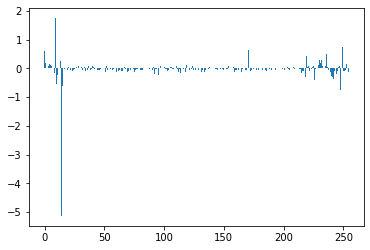

In [26]:
# Get importance
importance = model_lr.coef_[0]

# Summarize feature importance
for i,v in enumerate(importance):
	print('Feature: %0d, Score: %.5f' % (i,v))
 
# Plot feature importance
plt.bar([x for x in range(len(importance))], importance)
plt.show()

In [30]:
df.iloc[:,14]

0           0.00
1           0.00
2          75.00
3          75.00
4          98.00
           ...  
119385     96.14
119386    225.43
119387    157.71
119388    104.40
119389    151.20
Name: adr, Length: 119390, dtype: float64

# Decision Tree

In [31]:
model_dt = tree.DecisionTreeClassifier().fit(X_train, y_train)
model_dt_prediction = model_dt.predict(X_test)
version_dt = accuracy_score(y_test, model_dt_prediction)
version_dt

0.8512857023201273

Kappa

In [32]:
kappa_dt = cohen_kappa_score(y_test, model_dt_prediction)
kappa_dt

0.6817275219656856

Feature importance

Feature: 0, Score: 0.11925
Feature: 1, Score: 0.02988
Feature: 2, Score: 0.05541
Feature: 3, Score: 0.01703
Feature: 4, Score: 0.03149
Feature: 5, Score: 0.01029
Feature: 6, Score: 0.00417
Feature: 7, Score: 0.00079
Feature: 8, Score: 0.00051
Feature: 9, Score: 0.02081
Feature: 10, Score: 0.00584
Feature: 11, Score: 0.01558
Feature: 12, Score: 0.00109
Feature: 13, Score: 0.07999
Feature: 14, Score: 0.02325
Feature: 15, Score: 0.05464
Feature: 16, Score: 0.00585
Feature: 17, Score: 0.00329
Feature: 18, Score: 0.00398
Feature: 19, Score: 0.00711
Feature: 20, Score: 0.00314
Feature: 21, Score: 0.00299
Feature: 22, Score: 0.00268
Feature: 23, Score: 0.00508
Feature: 24, Score: 0.00385
Feature: 25, Score: 0.00366
Feature: 26, Score: 0.00552
Feature: 27, Score: 0.00296
Feature: 28, Score: 0.00380
Feature: 29, Score: 0.00301
Feature: 30, Score: 0.00418
Feature: 31, Score: 0.00096
Feature: 32, Score: 0.00368
Feature: 33, Score: 0.00314
Feature: 34, Score: 0.00068
Feature: 35, Score: 0.00012
Fe

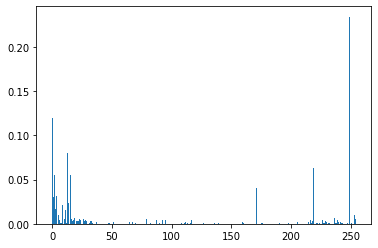

In [33]:
# get importance

importance = model_dt.feature_importances_

# summarize feature importance

for i,v in enumerate(importance):
	print('Feature: %0d, Score: %.5f' % (i,v))

# plot feature importance

plt.bar([x for x in range(len(importance))], importance)
plt.show()

In [34]:
X.iloc[:,0].head(1)

0    342
Name: lead_time, dtype: int64

In [35]:
X.iloc[:,249].head(1)

0    0
Name: deposit_type_Non Refund, dtype: uint8

# K-Fold Decision Tree

Maximum:  0.9698492462311558
Mean:  0.8117479877013705


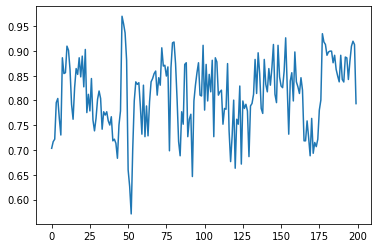

In [39]:
dt_plot_DV = cross_val_score(tree.DecisionTreeClassifier(max_depth =8), X, y, cv=200)   # Best result with max_depth =8), X, y, cv=200
print('Maximum: ', dt_plot_DV.max())
print('Mean: ', dt_plot_DV.mean())
dt_plot_DV = pd.Series(dt_plot_DV)
dt_plot_DV.plot()

In [ ]:
# KNN
model_knn = KNeighborsClassifier(n_neighbors = 6, metric = 'minkowski', p = 2).fit(X_train, y_train)
model_knn_prediction = model_knn.predict(X_test)
version_knn = accuracy_score(y_test, model_knn_prediction)
version_knn

In [15]:
kappa_knn = cohen_kappa_score(y_test, model_knn_prediction)
kappa_knn

0.6174669767237024

In [53]:
# Random Forest
model_rf = RandomForestClassifier(n_estimators=800).fit(X_train, y_train)
model_rf_prediction = model_rf.predict(X_test)
version_rf = accuracy_score(y_test, model_rf_prediction)
version_rf

0.8913225563280006

In [54]:
kappa_rf = cohen_kappa_score(y_test, model_rf_prediction)
kappa_rf

0.761949429146883

Feature: 0, Score: 0.11472
Feature: 1, Score: 0.02394
Feature: 2, Score: 0.06015
Feature: 3, Score: 0.02607
Feature: 4, Score: 0.03989
Feature: 5, Score: 0.01441
Feature: 6, Score: 0.00665
Feature: 7, Score: 0.00092
Feature: 8, Score: 0.00246
Feature: 9, Score: 0.02985
Feature: 10, Score: 0.00438
Feature: 11, Score: 0.01913
Feature: 12, Score: 0.00348
Feature: 13, Score: 0.07725
Feature: 14, Score: 0.02065
Feature: 15, Score: 0.05419
Feature: 16, Score: 0.00714
Feature: 17, Score: 0.00696
Feature: 18, Score: 0.00578
Feature: 19, Score: 0.00700
Feature: 20, Score: 0.00411
Feature: 21, Score: 0.00467
Feature: 22, Score: 0.00369
Feature: 23, Score: 0.00705
Feature: 24, Score: 0.00587
Feature: 25, Score: 0.00525
Feature: 26, Score: 0.00621
Feature: 27, Score: 0.00385
Feature: 28, Score: 0.00536
Feature: 29, Score: 0.00467
Feature: 30, Score: 0.00683
Feature: 31, Score: 0.00094
Feature: 32, Score: 0.00498
Feature: 33, Score: 0.00373
Feature: 34, Score: 0.00102
Feature: 35, Score: 0.00033
Fe

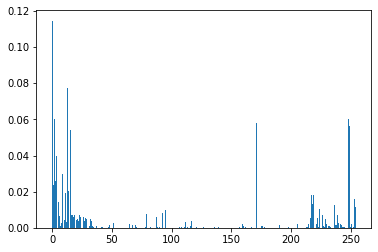

In [44]:
# get importance
importance = model_rf.feature_importances_
# summarize feature importance
for i,v in enumerate(importance):
	print('Feature: %0d, Score: %.5f' % (i,v))
# plot feature importance
plt.bar([x for x in range(len(importance))], importance)
plt.show()

In [ ]:
# Removing unnecessary columns 